In [2]:
include("multi_armed_bandit.jl")

   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`


run_bandit_problems (generic function with 1 method)

In [6]:
K = UInt(10)
RUN_LENGTH_STEPS = 2500
NUM_RUNS = 150

epsilons = [0.25, 0.1, 0.05, 0.01, 0.0]
num_eps = length(epsilons)
avg_rewards = zeros(Float64, RUN_LENGTH_STEPS, num_eps)
stddev_rewards = zeros(Float64, RUN_LENGTH_STEPS, num_eps)
avg_pct_optimal = zeros(Float64, RUN_LENGTH_STEPS, num_eps)


reward_variance = 0.001

SEED = 628
bp_rng = MersenneTwister(SEED)

MersenneTwister(628)

In [7]:
avg_rewards_eps_0_1 = nothing
stddev_rewards_eps_0_1 = nothing
avg_pct_optimal_eps_0_1 = nothing

for i in eachindex(epsilons)
    #reward_means, reward_stddevs, pct_optimal = run_bandit_problems(NUM_RUNS, RUN_LENGTH_STEPS, epsilons[i], K, reward_variance, bp_rng)
    #avg_rewards[:, i] = reward_means
    #stddev_rewards[:, i] = reward_stddevs
    #avg_pct_optimal[:, i] = pct_optimal
    (all_avg_reward_per_step, all_stddev_reward_per_step, all_avg_pct_optimal) = run_bandit_problems(NUM_RUNS, RUN_LENGTH_STEPS, epsilons[i], K, reward_variance, bp_rng)
    
    if i == 2
        avg_rewards_eps_0_1 = all_avg_reward_per_step
        stddev_rewards_eps_0_1 = all_stddev_reward_per_step
        avg_pct_optimal_eps_0_1 = all_avg_pct_optimal
    end
    
    avg_rewards[:, i] = mean(all_avg_reward_per_step, dims=2)
    stddev_rewards[:, i] = mean(all_stddev_reward_per_step, dims=2)
    avg_pct_optimal[:, i] = mean(all_avg_pct_optimal, dims=2)
end

size of all_avg_pct_optimal = (2500, 150)
size of all_avg_pct_optimal = (2500, 150)
size of all_avg_pct_optimal = (2500, 150)
size of all_avg_pct_optimal = (2500, 150)
size of all_avg_pct_optimal = (2500, 150)


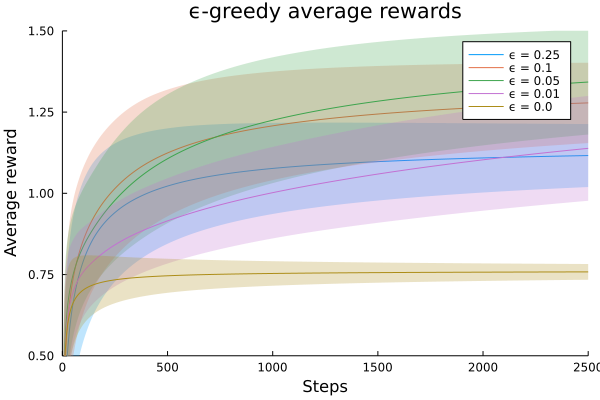

In [8]:
#σs = ones(length(avg_rewards))
plot(1:RUN_LENGTH_STEPS, avg_rewards,
    label=["ϵ = 0.25" "ϵ = 0.1" "ϵ = 0.05" "ϵ = 0.01" "ϵ = 0.0"],
    xlims=(0, RUN_LENGTH_STEPS),
    ylims=(0.5, 1.5),
    xlabel="Steps",
    ylabel="Average reward",
    title="ϵ-greedy average rewards",
    grid=false,ribbon=1.0 .* stddev_rewards,fillalpha=.25)


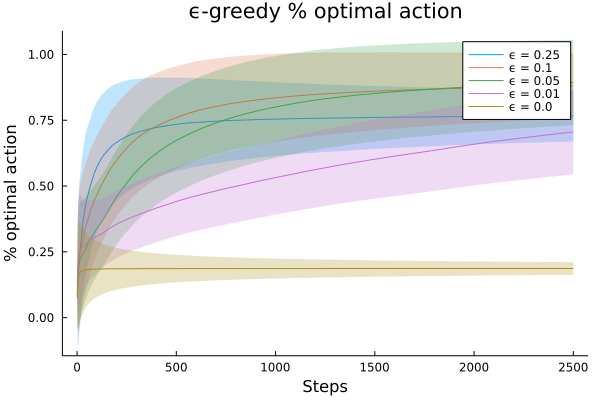

In [9]:
#σs = ones(length(avg_rewards))
plot(1:RUN_LENGTH_STEPS, avg_pct_optimal,
    label=["ϵ = 0.25" "ϵ = 0.1" "ϵ = 0.05" "ϵ = 0.01" "ϵ = 0.0"],
    #xlims=(0, RUN_LENGTH_STEPS),
    #ylims=(0., 1.25),
    xlabel="Steps",
    ylabel="% optimal action",
    title="ϵ-greedy % optimal action",
    grid=false,ribbon=1.0 .* stddev_rewards,fillalpha=.25)


In [ ]:
size(avg_rewards_eps_0_1)

In [10]:
# show individual avg rewards for ϵ = 0.1
plot(1:RUN_LENGTH_STEPS, avg_rewards_eps_0_1,
    label=nothing,
    xlims=(0, RUN_LENGTH_STEPS),
    ylims=(0., 2.5),
    xlabel="Steps",
    ylabel="Average reward",
    title="ϵ = 0.1, ϵ-greedy average rewards",
    grid=false,ribbon=0.1 .* stddev_rewards_eps_0_1, fillalpha=.5)

In [11]:
# show individual optimal action % for ϵ = 0.1
plot(1:RUN_LENGTH_STEPS, avg_pct_optimal_eps_0_1,
    label=nothing,
    xlims=(0, RUN_LENGTH_STEPS),
    ylims=(0., 1.25),
    xlabel="Steps",
    ylabel="% Optimal action",
    title="ϵ = 0.1, ϵ-greedy % optimal action")